# A Pytorch Implementation of [U2Fusion](https://ieeexplore.ieee.org/abstract/document/9151265).

U2Fusion is a unified unsupervised end-to-end image fusion network and is capable of solving different fusion problems, including multi-modal, multi-exposure, and multi-focus cases. Using feature extraction and information measurement, U2Fusion automatically estimates the importance of corresponding source images and comes up with adaptive information preservation degrees. Hence, different fusion tasks are unified in the same framework. Based on the adaptive degrees, a network is trained to preserve the adaptive similarity between the fusion result and source images. Therefore, the stumbling blocks in applying deep learning for image fusion, e.g., the requirement of ground-truth and specifically designed metrics, are greatly mitigated.

In [1]:
import os
import random
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from pytorch_msssim import ssim
from typing import Tuple, Optional, List
DATA_DIR = os.path.join('..', 'data')

## Data

In [2]:
class RoadSceneDataset(Dataset):
    def __init__(self,
                 transforms_: nn.Module,
                 patch_size: int=0):
        self.patch_size = patch_size
        DIR = os.path.join(DATA_DIR, 'RoadScene')
        self.path_vis = os.path.join(DIR, 'crop_LR_visible')
        self.path_inf = os.path.join(DIR, 'cropinfrared')
        self.transform = transforms_
        self.files_vis = os.listdir(self.path_vis)
        self.files_inf = os.listdir(self.path_inf)

    def __getitem__(self,
                    index) -> Tuple[torch.Tensor]:
        vis = mpimg.imread(os.path.join(self.path_vis, self.files_vis[index]))
        inf = mpimg.imread(os.path.join(self.path_inf, self.files_inf[index]))
        if self.patch_size:
            return self.get_patch(vis, inf)
        return self.transform(vis), self.transform(inf)

    def __len__(self) -> int:
        return max(len(self.files_vis), len(self.files_inf))

    def get_patch(self,
                  vis: np.ndarray,
                  inf: np.ndarray) -> Tuple[torch.Tensor]:
        stride = self.patch_size
        h, w, _ = vis.shape
        x, y = random.randint(0, h - stride), random.randint(0, w - stride)
        return self.transform(vis[x: x + stride, y: y + stride, :]), \
                self.transform(inf[x: x + stride, y: y + stride])

In [3]:
class LytroDataset(Dataset):
    def __init__(self,
                 transforms_: nn.Module,
                 patch_size: int = 0):
        self.patch_size = patch_size
        DIR = os.path.join(DATA_DIR, 'Lytro')
        self.path_vis = os.path.join(DIR, 'A')
        self.path_inf = os.path.join(DIR, 'B')
        self.transform = transforms_
        self.files_vis = os.listdir(self.path_vis)
        self.files_inf = os.listdir(self.path_inf)

    def __getitem__(self,
                    index: int) -> Tuple[torch.Tensor]:
        vis = mpimg.imread(os.path.join(self.path_vis, self.files_vis[index]))
        inf = mpimg.imread(os.path.join(self.path_inf, self.files_inf[index]))
        if self.patch_size:
            return self.get_patch(vis, inf)
        return self.transform(vis), self.transform(inf)

    def __len__(self) -> int:
        return max(len(self.files_vis), len(self.files_inf))

    def get_patch(self,
                  vis: np.ndarray,
                  inf: np.ndarray) -> Tuple[torch.Tensor]:
        stride = self.patch_size
        h, w, _ = vis.shape
        x, y = random.randint(0, h - stride), random.randint(0, w - stride)
        return self.transform(vis[x: x + stride, y: y + stride, :]), \
                self.transform(inf[x: x + stride, y: y + stride, :])

In [17]:
output_dir = 'output'
if not os.path.exists(output_dir):
    os.mkdir(output_dir)
for i in range(1, 4):
    p = os.path.join(output_dir, f'task_{i}')
    if not os.path.exists(p):
        os.mkdir(p)

## Model
The U2Fusion adopts the pre-trained VGG-16 network for feature extraction. The outputs of the convolutional layers before max-pooling layers are feature maps for the subsequent information measurement, which are represented by $\phi_{C_1}(I),\cdots,\phi _{c_5}(I)$.

To measure the information contained in the extracted feature maps, their gradients are used for evaluation. The information measurement is defined as follows:

$$g_I=\frac{1}{5} \sum_{j=1}^{5}\frac{1}{H_jW_jD_j} \sum_{k=1}^{D_j}||\nabla \phi_{C_j^k(I)}||_F^2$$

where $\phi_{C_j}(I)$ is the feature map by the convolutional layer before the $j$th max-pooling layer; $k$ denotes the feature map in $k$th channel of $D_j$ channels; $|| \cdot ||_F$ denotes the Frobenius norm; $\nabla$ is the Laplacian operator.

In [5]:
# calulate gradients of feature map
def grad(img: torch.Tensor) -> torch.Tensor:
    kernel = torch.tensor([[1 / 8, 1 / 8, 1 / 8], [1 / 8, -1, 1 / 8], [1 / 8, 1 / 8, 1 / 8]]).unsqueeze(0).unsqueeze(0).to(img.device)
    c = img.shape[1]
    return torch.cat([F.conv2d(img[:, i: i + 1, :, :], kernel, padding='same') for i in range(c)], dim=1)

# calulate the information measurement
def g(x: torch.Tensor) -> torch.Tensor:
    return torch.mean(torch.pow(grad(x), 2), dim=[1, 2, 3])

For VGG16, there is a pretrained VGG-16 model available in torchvision. The original VGG16 model has 528MB of parameters. Since U2Fusion only uses the first 29 layers of VGG-16 up to the fifth MaxPooling layer, I extracted the first 29 layers of the original VGG16. The parameter size of the extracted model is only 58MB. I integrate the calulation of gradients and information measurement into the extracted model and you **only** need to run the following code snippet **once** to save it.

In [6]:
import torchvision
VGG_16 = torchvision.models.vgg16(weights="DEFAULT")

class VGG16(nn.Module):
    def __init__(self) -> None:
        super(VGG16, self).__init__()
        self.phi1 = VGG_16.features[: 4]
        self.phi2 = VGG_16.features[4: 9]
        self.phi3 = VGG_16.features[9: 16]
        self.phi4 = VGG_16.features[16: 23]
        self.phi5 = VGG_16.features[23: 30]
    def forward(self,
                x: torch.Tensor) -> torch.Tensor:
        x1 = self.phi1(x)
        x2 = self.phi2(x1)
        x3 = self.phi3(x2)
        x4 = self.phi4(x3)
        x5 = self.phi5(x4)
        return (g(x1) + g(x2) + g(x3) + g(x4) + g(x5)) / 5

net = VGG16()
torch.save(net, f'{output_dir}/vgg16.pth')

DenseNet is employed to generate the fusion result $I_f$, of which the input is the concatenation of $I_1$ and $I_2$. I follow the architecture of DensetNet (Fig.8) used in U2Fusion.

In [7]:
class DenseNet(nn.Module):
    def __init__(self,
                 in_channels: int) -> None:
        super(DenseNet, self).__init__()
        self.conv1 = nn.Conv2d(2 * in_channels, 44, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(44, 44, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv3 = nn.Conv2d(88, 44, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv4 = nn.Conv2d(132, 44, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv5 = nn.Conv2d(176, 44, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv6 = nn.Conv2d(220, 44, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv7 = nn.Conv2d(264, 128, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv8 = nn.Conv2d(128, 64, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv9 = nn.Conv2d(64, 32, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv10 = nn.Conv2d(32, 1, kernel_size=3, padding=1, padding_mode='reflect')

    def forward(self,
                I1: torch.Tensor,
                I2: torch.Tensor) -> torch.Tensor:
        x1 = F.leaky_relu(self.conv1(torch.cat([I1, I2], 1)), 0.2)
        x2 = torch.cat([x1, F.leaky_relu(self.conv2(x1), 0.2)], 1)
        x3 = torch.cat([x2, F.leaky_relu(self.conv3(x2), 0.2)], 1)
        x4 = torch.cat([x3, F.leaky_relu(self.conv4(x3), 0.2)], 1)
        x5 = torch.cat([x4, F.leaky_relu(self.conv5(x4), 0.2)], 1)
        x6 = torch.cat([x5, F.leaky_relu(self.conv6(x5), 0.2)], 1)
        x7 = F.leaky_relu(self.conv7(x6), 0.2)
        x8 = F.leaky_relu(self.conv8(x7), 0.2)
        x9 = F.leaky_relu(self.conv9(x8), 0.2)
        return F.tanh(self.conv10(x9))

## Config

In [9]:
def RGB2YCrBr(im: np.ndarray) -> np.ndarray:
    if len(im.shape) == 2:
        return im
    tran_matrix = np.array([[0.299, 0.5, -0.169], [0.587, -0.419, -0.331], [0.114, -0.081, 0.5]])
    return np.matmul(im, tran_matrix).astype(np.uint8) + np.array([0, 128, 128], dtype=np.uint8)

# def YCrBr2RGB(im):
#     tran_matrix = np.array([[1., 1., 1.], [1.403, -0.714, 0.], [0., -0.344, 1.773]])
#     return np.matmul(im * 255. - np.array([0, 128, 128]), tran_matrix).astype(np.uint8)

def YCrBr2RGB(im: np.ndarray) -> np.ndarray:
    tran_matrix = np.array([[1., 1., 1.], [1.403, -0.71414, 0.], [0., -0.34414, 1.773]])
    img = np.matmul(im - np.array([0, 0.5, 0.5]), tran_matrix)
    img[img > 1] = 1
    img[img < 0] = 0
    return img

transforms_ = transforms.Compose([
    transforms.Lambda(RGB2YCrBr),
    transforms.ToTensor()
])

batch_size, patch_size = 4, 64

device = 'cuda' if torch.cuda.is_available() else 'cpu'
vgg_16 = torch.load(f'{output_dir}/vgg16.pth', weights_only=False).to(device)
model = DenseNet(3).to(device)

## Train

**Information Preservation Degree:** To preserve the information in source images, two adaptive weights are assigned as the information preservation degrees, which define the weights of similarities between the fusion image and the source images. These adaptive weights, denoted as $w_1$ and $w_2$, are estimated according to the information measurement results $g_{I_1}$ and $g_{I_2}$ (the output of VGG16 in my implementation). $w_1$ and $w_2$ are defined as:

$$[w_1,w_2]=\text{softmax}([\frac{g_{I_1}}{c},\frac{g_{I_2}}{c}])$$

Then $w_1$ and $w_2$ are employed in the loss function to control the information preservation degrees of specific source images.

**Loss Function:** The loss function consists of two parts:

$$\mathcal{L}(\theta,D)= \mathcal{L}_{\text{sim}}(\theta,D)+ \lambda  \mathcal{L}_{\text{ewc}}(\theta,D)$$

where $\theta$ denotes the parameters in DenseNet, and $D$ is the training dataset. $\mathcal{L}_{\text{sim}}(\theta,D)$ is the similarity loss between the result and source images. $\mathcal{L}_{\text{ewc}}(\theta,D)$ is the item designed for continual learning. $\lambda$ is a hyperparameter to control the trade-off.

$\mathcal{L}_{\text{sim}}(\theta,D)$ consists of two parts:

$$
	\begin{array}{c}
		\mathcal{L}_{\text{ssim} }(\theta,D)= \mathbb{E}[w_1\cdot (1-S_{I_f,I_1})+w_2\cdot (1-S_{I_f,I_2})] \\
		\mathcal{L}_{\text{mse} }(\theta,D)= \mathbb{E}[w_1\cdot \text{MSE}_{I_f,I_1}+w_2\cdot \text{MSE}_{I_f,I_2}]\\
		\mathcal{L}_{\text{sim} }(\theta,D)= \mathcal{L}_{\text{ssim} }(\theta,D)+\alpha\mathcal{L}_{\text{mse} }(\theta,D)
	\end{array}
$$

where $\mathcal{L}_{\text{ssim} }(\theta,D)$ constraints the structure similarity and $\mathcal{L}_{\text{sim} }(\theta,D)$ constraints the intensity distribution, with $\alpha$ controlling the trade-off.

**EWC:** In sequential training, the parameters are optimized to solve the new problems while losing the capacity learned from previous tasks as the training process continues. The problem is called catastrophic forgetting. To avoid this drawback, the U2Fusion applies the *elastic weight consolidation* algorithm to safeguard against it.

The loss for continual learning, termed as $\mathcal{L}_{\text{ewc}}(\theta,D)$, is formulated as ($*$ indicates the previous task):

$$\mathcal{L}_{\text{ewc}}(\theta,D)=\frac{1}{2}\sum_{i} \mu_i(\theta_i-\theta_i^\ast )^2$$

where $i$ represents the $i$ th parameter in the network and $\mu_i$ represents the weight of corresponding squared distance (high weight indicates that the parameter is important and shouldn't be significantly updated).

$\mu_i$ is assigned as the diagonal terms of the Fisher information matrix and can be approximately replaced by $-\mathcal{L}(\theta^\ast,D^\ast)$:

$$\mu_i=\mathbb{E} \left [\left (-\frac{\partial }{\partial \theta_i^\ast} \mathcal{L}(\theta^\ast,D^\ast)  \right )^2|\theta ^\ast \right ]$$

After each task is trained, I use `optim.zero_grad()` to set the gradients of the parameters to zero, and then calculate the loss function once again. Instead of calling `optim.zero_grad()` to clear the gradients during each backpropagation, let the gradients accumulate continuously. After iterating through the entire dataset, the gradients of each parameter can be obtained. Taking the square of these gradients gives the values of $\mu_i$. 

In [ ]:
def train(vgg_16: VGG16,
          model: DenseNet,
          data_loader: DataLoader,
          device: str = 'cuda',
          alpha: float = 20,
          lamb: float = 8e4,
          c: float = 3e3,
          epochs: int = 3,
          lr: float = 1e-4) -> None:    
    last = fisher_information = None
    if os.path.exists(f'{output_dir}/model.pth'):
        last = torch.load(f'{output_dir}/model.pth', weights_only=False)
    if os.path.exists(f'{output_dir}/fisher_information.pth'):
        fisher_information = torch.load(f'{output_dir}/fisher_information.pth', weights_only=False)
    
    optim = torch.optim.Adam(params=model.parameters(), lr=lr)
    # optim = torch.optim.RMSprop(params=model.parameters(), lr=lr, weight_decay=0.6, momentum=0.15)
    
    for epoch in range(epochs):
        total_loss = total = 0
        model.train()
        # shape of vis: b, 3, h, w; shape of inf: b, 1, h, w
        for vis, inf in data_loader:
            with torch.no_grad():
                # shape of I1, I2: b, 3, h, w
                I1, I2 = vis[:, :1, :, :].to(device), inf[:, :1, :, :].to(device)
                # I1, I2 = vis.repeat_interleave(repeats, dim=1).to(device), inf.repeat_interleave(repeats[0], dim=1).to(device)
                # shape of g_I1, g_I2: b
                g_I1, g_I2 = vgg_16(I1.repeat_interleave(3, dim=1)), vgg_16(I2.repeat_interleave(3, dim=1))
                # shape of w1, w2: b
                w1, w2 = F.softmax(torch.cat([g_I1 / c, g_I2 / c]).reshape(2, -1), dim=0)
            # shape of If: b, 1, h, w
            If = model(I1.repeat_interleave(3, dim=1), I2.repeat_interleave(3, dim=1))
            # shape of loss_ssim, loss_mse: b
            loss_ssim = w1 * (1 - ssim(If, I1, data_range=1.0, size_average=False)) + w2 * (1 - ssim(If, I2, data_range=1.0, size_average=False))
            loss_mse = w1 * F.mse_loss(If, I1, reduction='none').mean(dim=[1, 2, 3]) + w2 * F.mse_loss(If, I2, reduction='none').mean(dim=[1, 2, 3])
            loss_sim = loss_ssim.mean() + alpha * loss_mse.mean()
            
            loss_ewc = 0
            if fisher_information and last:
                for mu, theta_star, theta in zip(fisher_information, last.values(), model.state_dict().values()):
                    loss_ewc += torch.sum(mu * torch.pow(theta - theta_star, 2))
            
            loss = loss_sim + lamb * loss_ewc
            
            total_loss += loss_sim.item()
            total += vis.shape[0]
            
            optim.zero_grad()
            loss.backward()
            optim.step()
        print(f'Epoch: {epoch + 1}, Train Loss: {total_loss / total:.4f}')

    # calucate the fisher information    
    optim.zero_grad()
    for vis, inf in data_loader:
        with torch.no_grad():
            # shape of I1, I2: b, 3, h, w
            I1, I2 = vis[:, :1, :, :].to(device), inf[:, :1, :, :].to(device)
            # shape of g_I1, g_I2: b
            g_I1, g_I2 = vgg_16(I1.repeat_interleave(3, dim=1)), vgg_16(I2.repeat_interleave(3, dim=1))
            # shape of w1, w2: 2 * b
            w1, w2 = F.softmax(torch.cat([g_I1 / c, g_I2 / c]).reshape(2, -1), dim=0)
        # shape of If: b, 6, h, w
        If = model(I1.repeat_interleave(3, dim=1), I2.repeat_interleave(3, dim=1))
        # shape of loss_ssim, loss_mse: b
        loss_ssim = w1 * (1 - ssim(If, I1, data_range=1.0, size_average=False)) + w2 * (1 - ssim(If, I2, data_range=1.0, size_average=False))
        loss_mse = w1 * F.mse_loss(If, I1, reduction='none').mean(dim=[1, 2, 3]) + w2 * F.mse_loss(If, I2, reduction='none').mean(dim=[1, 2, 3])
        loss_sim = loss_ssim.mean() + alpha * loss_mse.mean()
        
        loss_ewc = 0
        if fisher_information and last:
            for mu, theta_star, theta in zip(fisher_information, last.values(), model.state_dict().values()):
                loss_ewc += torch.sum(mu * torch.pow(theta - theta_star, 2))
            
        loss = loss_sim + lamb * loss_ewc
        
        loss.backward()

    fisher_information = []
    for v in model.parameters():
        fisher_information.append(v.grad ** 2)
    torch.save(fisher_information, f'{output_dir}/fisher_information.pth')
    torch.save(model.state_dict(), f'{output_dir}/model.pth')

The Y channel of the fusion image is the output of DenseNet. Fusion image in the Cb/Cr channel is obtained by:

$$C_f=\frac{C_1(|C_1-\tau |)+C_2(|C_2-\tau|)}{|C_1-\tau |+|C_2-\tau|}$$

where C1 and C2 are the Cb/Cr channel values of the first and second source image, respectively. $\tau$ is set as 128.

In [ ]:
def test(model: DenseNet,
         data_loader: DataLoader,
         device: str = 'cuda',
         show: int = 20,
         tau: float = 0.5,
         task: int = 1) -> None:
    model.eval()
    for i, (vis, inf) in enumerate(data_loader):
        if i >= show:
            break
        with torch.no_grad():
            I1, I2 = vis[:, :1, :, :].to(device), inf[:, :1, :, :].to(device)
            If = model(I1.repeat_interleave(3, dim=1), I2.repeat_interleave(3, dim=1))
            C1, C2 = vis[:, 1:, :, :], inf[:, 1:, :, :]
            if C1.shape[1] and C2.shape[1]:
                Cf = (C1 * torch.abs(C1 - tau) + C2 * torch.abs(C2 - tau)) / (torch.abs(C1 - tau) + torch.abs(C2 - tau))
            elif C1.shape[1]:
                Cf = C1
            else:
                Cf = C2
            fusion = YCrBr2RGB(torch.cat([If.cpu(), Cf.cpu()], dim=1)[0].permute(1, 2, 0).numpy())
            if vis.shape[1] > 1:
                src1 = YCrBr2RGB(vis[0].permute(1, 2, 0).numpy())
            else:
                src1 = vis[0].permute(1, 2, 0).numpy()
            if inf.shape[1] > 1:
                src2 = YCrBr2RGB(inf[0].permute(1, 2, 0).numpy())
            else:
                src2 = inf[0].permute(1, 2, 0).numpy()
            
        plt.figure(figsize=(8, 6), dpi=300)
        plt.subplot(1, 3, 1)
        plt.imshow(src1, vmin=0, vmax=1)
        plt.axis('off')
        plt.subplot(1, 3, 2)
        plt.imshow(src2, cmap='gray', vmin=0, vmax=1)
        plt.axis('off')
        plt.subplot(1, 3, 3)
        plt.imshow(fusion, vmin=0, vmax=1)
        plt.axis('off')
        plt.savefig(f'{output_dir}/task_{task}/{i + 1:03d}.jpg', bbox_inches='tight')
        # plt.show()

In [12]:
# Task1: Multi-Modal
train_set1 = RoadSceneDataset(transforms_, patch_size=patch_size)
train_loader1 = DataLoader(train_set1, batch_size, shuffle=True)
train(vgg_16, model, train_loader1, device, epochs=20)

d:\Environment\miniconda\Lib\site-packages\torchvision\transforms\functional.py:154: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at C:\cb\pytorch_1000000000000\work\torch\csrc\utils\tensor_numpy.cpp:212.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


Epoch: 1, Train Loss: 0.6091
Epoch: 2, Train Loss: 0.2419
Epoch: 3, Train Loss: 0.2337
Epoch: 4, Train Loss: 0.2100
Epoch: 5, Train Loss: 0.2048
Epoch: 6, Train Loss: 0.2123
Epoch: 7, Train Loss: 0.1921
Epoch: 8, Train Loss: 0.1910
Epoch: 9, Train Loss: 0.2076
Epoch: 10, Train Loss: 0.1835
Epoch: 11, Train Loss: 0.1957
Epoch: 12, Train Loss: 0.1911
Epoch: 13, Train Loss: 0.2003
Epoch: 14, Train Loss: 0.2102
Epoch: 15, Train Loss: 0.1918
Epoch: 16, Train Loss: 0.1745
Epoch: 17, Train Loss: 0.2134
Epoch: 18, Train Loss: 0.1831
Epoch: 19, Train Loss: 0.2148
Epoch: 20, Train Loss: 0.1776


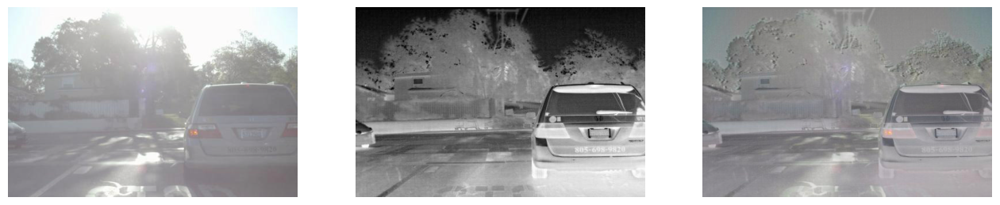

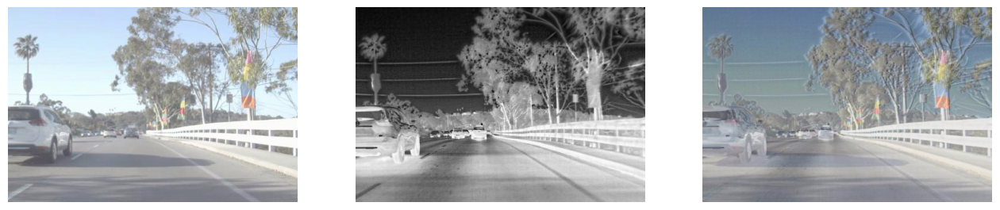

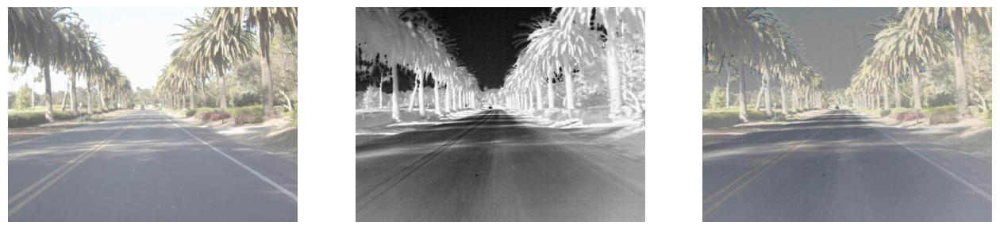

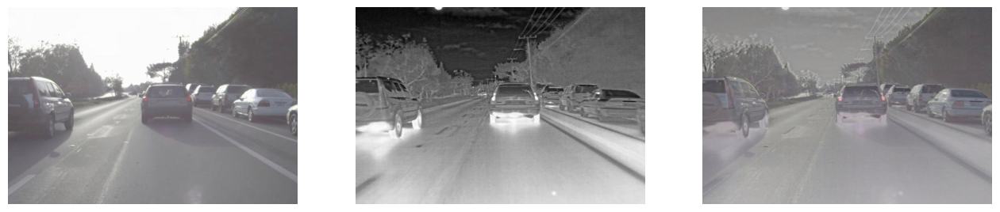

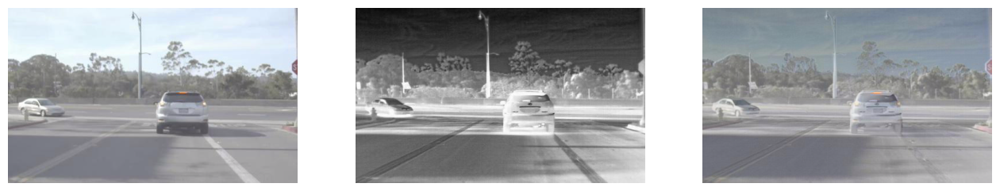

...

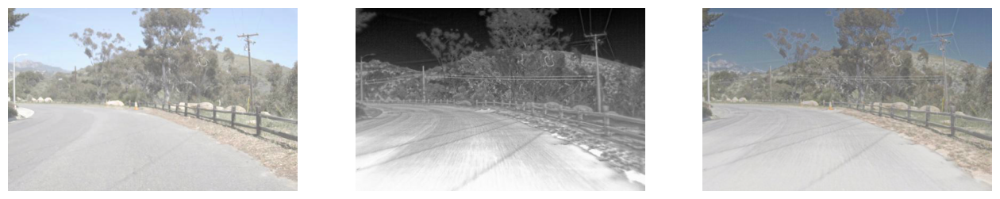

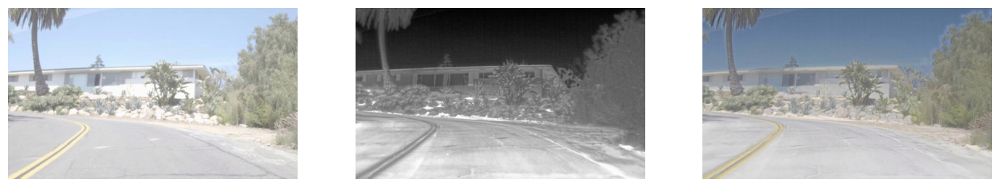

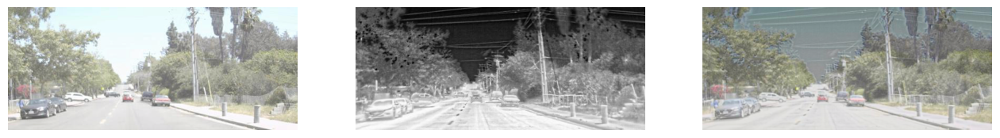

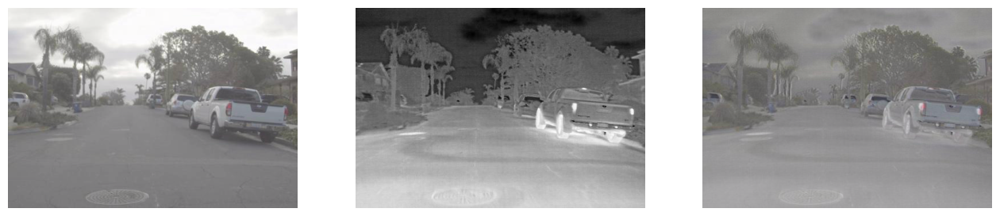

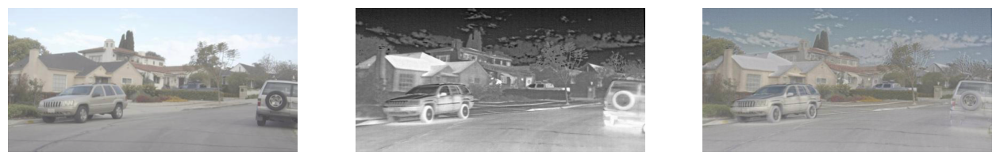

In [ ]:
test_set1 = RoadSceneDataset(transforms_)
test_loader1 = DataLoader(test_set1, 1)
test(model, test_loader1)

In [14]:
# Task2: Multi-Focus
train_set2 = LytroDataset(transforms_, patch_size=patch_size)
train_loader2 = DataLoader(train_set2, batch_size=4, shuffle=True)
train(vgg_16, model, train_loader2, device, c=1e2, epochs=20)

Epoch: 1, Train Loss: 0.0516
Epoch: 2, Train Loss: 0.0524
Epoch: 3, Train Loss: 0.0349
Epoch: 4, Train Loss: 0.0465
Epoch: 5, Train Loss: 0.0305
Epoch: 6, Train Loss: 0.0407
Epoch: 7, Train Loss: 0.0407
Epoch: 8, Train Loss: 0.0466
Epoch: 9, Train Loss: 0.0401
Epoch: 10, Train Loss: 0.0399
Epoch: 11, Train Loss: 0.0460
Epoch: 12, Train Loss: 0.0450
Epoch: 13, Train Loss: 0.0380
Epoch: 14, Train Loss: 0.0333
Epoch: 15, Train Loss: 0.0412
Epoch: 16, Train Loss: 0.0361
Epoch: 17, Train Loss: 0.0249
Epoch: 18, Train Loss: 0.0417
Epoch: 19, Train Loss: 0.0447
Epoch: 20, Train Loss: 0.0364


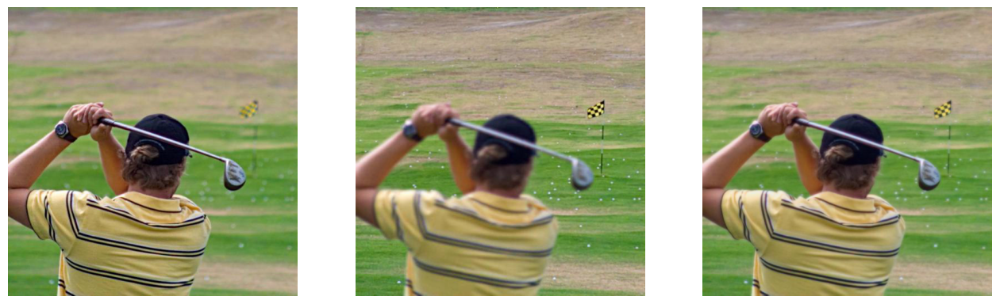

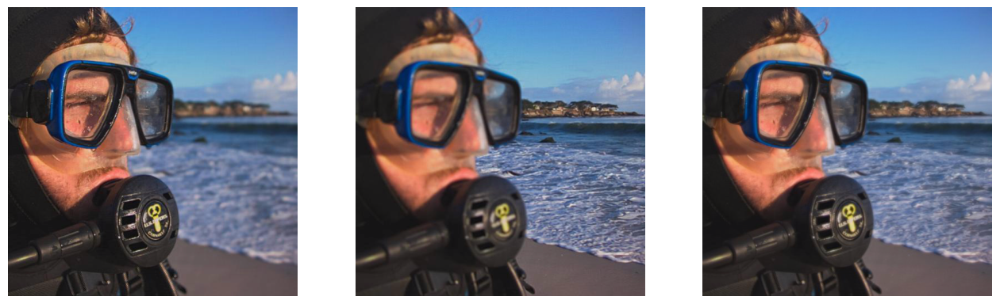

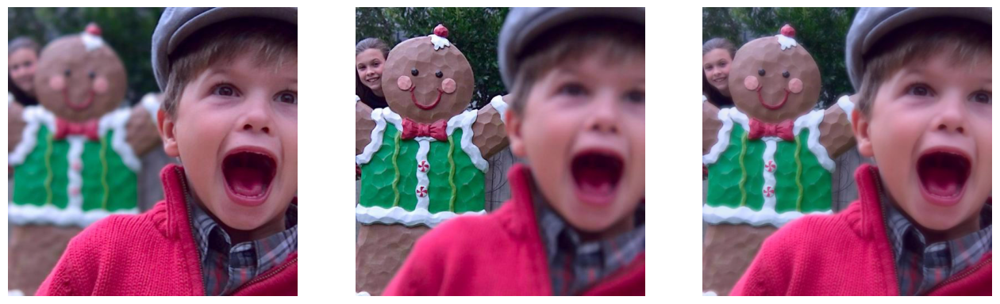

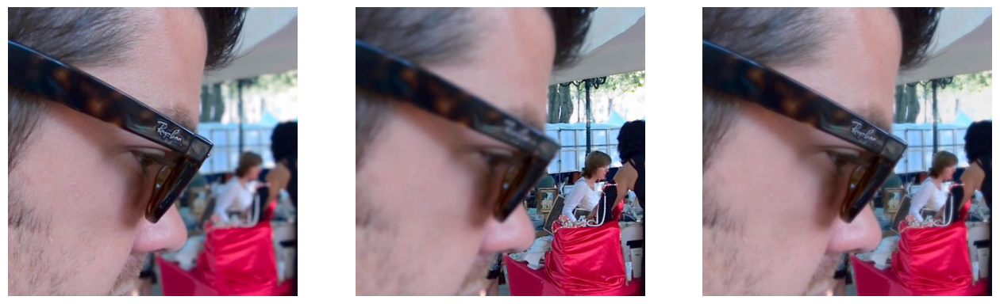

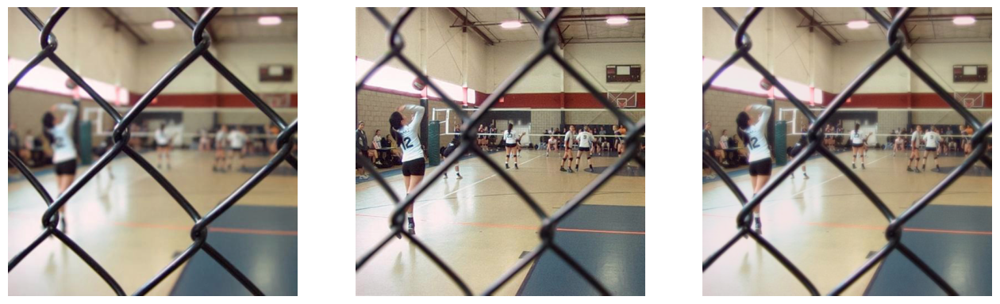

...

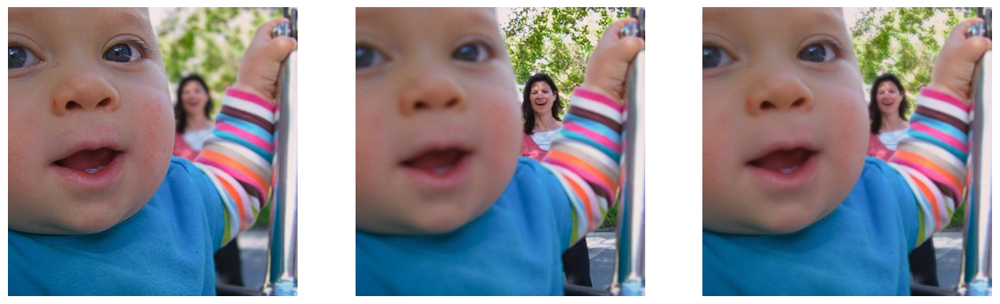

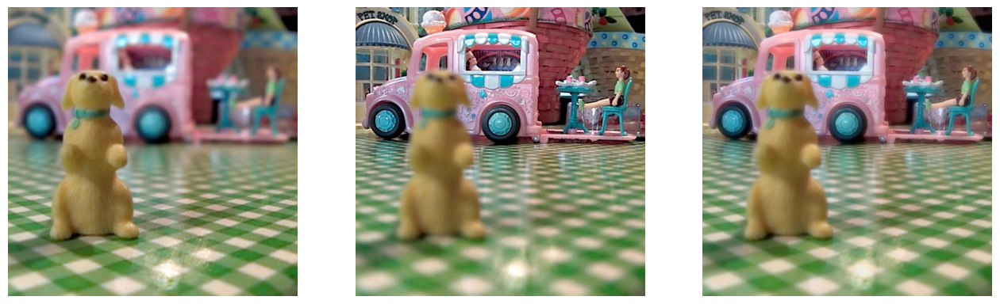

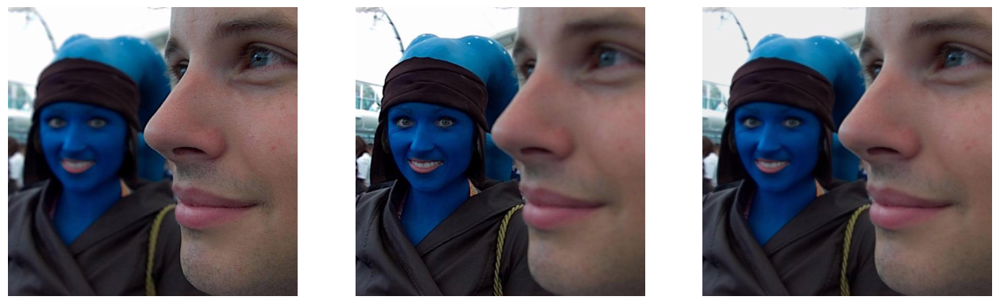

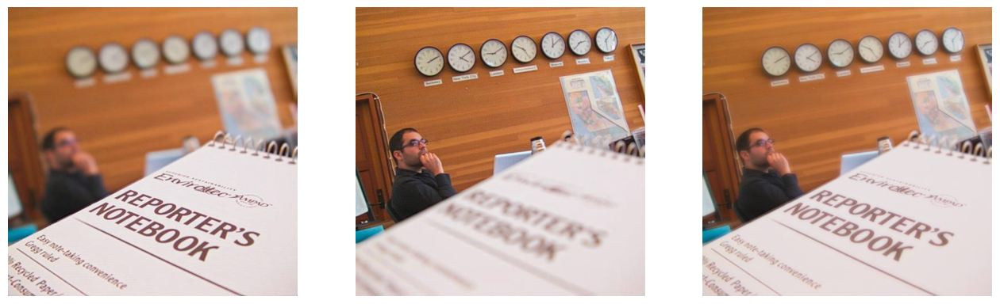

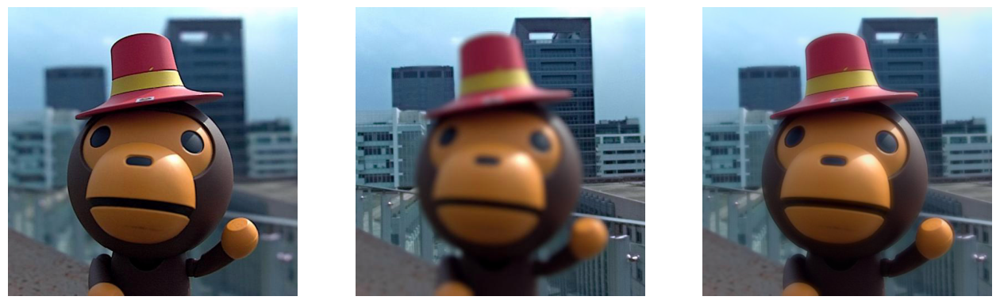

In [ ]:
test_set2 = LytroDataset(transforms_)
test_loader2 = DataLoader(test_set2, 1)
test(model, test_loader2, task=2)

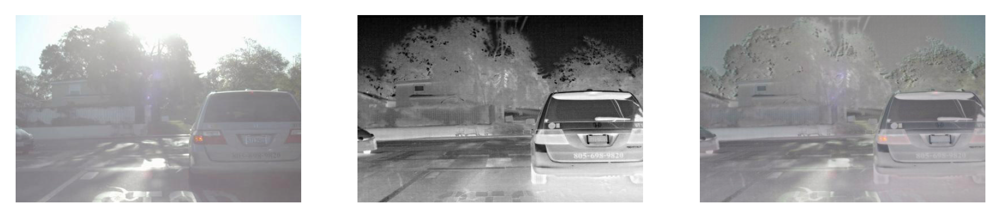

In [27]:
# Task 3: Multi-Modal  after Task2
test_set1 = RoadSceneDataset(transforms_)
test_loader1 = DataLoader(test_set1, 1)
test(model, test_loader1, show=1, task=3)